<a href="https://colab.research.google.com/github/chamznator/ML-projects/blob/main/Watermark_Remover.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Watermark Remover**

Google Colab Link: https://colab.research.google.com/drive/18KZiTTDXisC3iwbID8erEZv8aSUbT-hN?usp=sharing



# **Data Loading and Splitting**

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Loading Images from Google Drive
import torch
import numpy as np
import torchvision
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
import matplotlib.pyplot as plt

# Location on Google Drive
master_path = '/content/gdrive/MyDrive/APS360 Project Group 33/aps360_final_splited/'

# Transform Settings - Do not use RandomResizedCrop
pixelh = 240
pixelw = 240
transform = transforms.Compose([transforms.Resize((pixelh,pixelw)), 
                                transforms.ToTensor()])

# Load data from Google Drive
train_wm = torchvision.datasets.ImageFolder(master_path + 'watermarked/train', transform=transform)
train_nowm = torchvision.datasets.ImageFolder(master_path + 'nowatermark/train', transform=transform)
if len(train_wm) == len(train_nowm):
  print(str(len(train_wm)) + " training samples uploaded. Equal amount for both class.")

valid_wm = torchvision.datasets.ImageFolder(master_path + 'watermarked/valid', transform=transform)
valid_nowm = torchvision.datasets.ImageFolder(master_path + 'nowatermark/valid', transform=transform)
if len(valid_wm) == len(valid_nowm):
  print(str(len(valid_wm)) + " validation samples uploaded. Equal amount for both class.")

test_wm = torchvision.datasets.ImageFolder(master_path + 'watermarked/test', transform=transform)
test_nowm = torchvision.datasets.ImageFolder(master_path + 'nowatermark/test', transform=transform)
if len(test_wm) == len(test_nowm):
  print(str(len(test_wm)) + " testing samples uploaded. Equal amount for both class.")

7000 training samples uploaded. Equal amount for both class.
1500 validation samples uploaded. Equal amount for both class.
1500 testing samples uploaded. Equal amount for both class.


In [ ]:
# Prepare Dataloader
batch_size = 16
num_workers = 1

class ConcatDataset(torch.utils.data.Dataset):
    def __init__(self, *datasets):
        self.datasets = datasets

    def __getitem__(self, i):
        return tuple(d[i] for d in self.datasets)

    def __len__(self):
        return min(len(d) for d in self.datasets)

train_loader = torch.utils.data.DataLoader(
             ConcatDataset(train_wm,train_nowm),
             batch_size=batch_size, shuffle=True,
             num_workers=num_workers, pin_memory=True)

valid_loader = torch.utils.data.DataLoader(
             ConcatDataset(valid_wm,valid_nowm),
             batch_size=batch_size, shuffle=True,
             num_workers=num_workers, pin_memory=True)

test_loader = torch.utils.data.DataLoader(
             ConcatDataset(test_wm,test_nowm),
             batch_size=batch_size, shuffle=True,
             num_workers=num_workers, pin_memory=True)

**Verification of Uploaded Data**

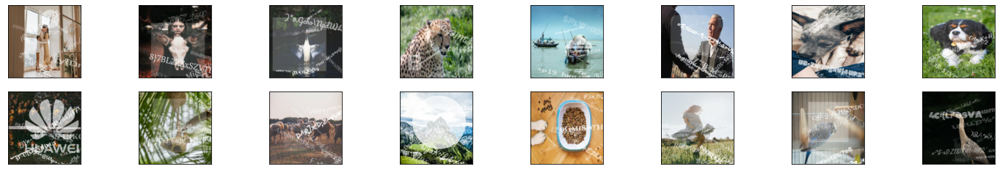

In [ ]:
# Verification Step - obtain one batch of images
dataiter = iter(train_loader) 
images, _ = dataiter.next()
images = images[0].numpy() # convert images to numpy for display

# plot the images in the batch
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(16):
    ax = fig.add_subplot(2, 8, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))

In [ ]:
# Verify that we could access the same image with and without watermarks.
for i, (wm, nowm) in enumerate(train_loader):
  imga = wm[0][0].permute(1,2,0) 
  imgb = nowm[0][0].permute(1,2,0) 
  break

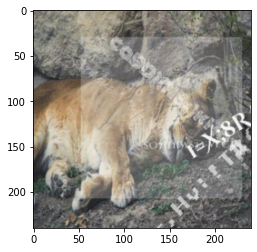

In [ ]:
plt.imshow(imga)

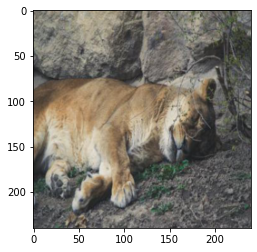

In [ ]:
plt.imshow(imgb)

# **Baseline Model**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim #for gradient descent
import matplotlib.pyplot as plt # for plotting
from torchvision import datasets, transforms

**Baseline Model Archiecture (Autoencoder)**

In [ ]:
# Baseline Model Architecture : Autoencoder

torch.manual_seed(42) # set the random seed

class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        encoding_dim = 1000
        # encoder
        self.fc1 = nn.Linear(pixelh * pixelw, encoding_dim)
        # decoder
        self.fc2 = nn.Linear(encoding_dim, pixelh*pixelw)

    def forward(self, img):
        flattened = img.view(-1, pixelh * pixelw)
        # x = F.relu(self.fc1(flattened))
        # sigmoid for scaling output from 0 to 1
        # x = F.sigmoid(self.fc2(x))
        x = self.fc1(flattened)
        x = self.fc2(x)
        return x

**Baseline Model Training**

In [ ]:
# Training Function of the Baseline Model
def train(model, num_epochs=5, batch_size=32, learning_rate=1e-3):
    torch.manual_seed(42)
    criterion = nn.MSELoss() # mean square error loss
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)
    outputs = []
    iters = []
    losses = []
    losses_valid = []

    for epoch in range(num_epochs):
            
        # train_loader
        for i, (wm, nowm) in enumerate(train_loader):
            imgwm = wm[0].view(-1, pixelh * pixelw)
            recon = model(wm[0].cuda())
            truth = nowm[0].view(-1, pixelh * pixelw)
            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              truth = truth.cuda()
              imgwm = imgwm.cuda()
            # sends truth to the gpu
            #############################################
            loss = criterion(recon, truth)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

        # validation_loader
        for i, (wm, nowm) in enumerate(valid_loader):
            recon_valid = model(wm[0].cuda())
            truth_valid = nowm[0].view(-1, pixelh * pixelw)
            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              truth_valid = truth_valid.cuda()
            # sends truth_valid to the gpu
            #############################################
            loss_valid = criterion(recon_valid, truth_valid)       

        # Track Training Accuracy
        print('Epoch:{}, Training Loss:{:.4f}, Validation Loss:{:.4f}'.format(epoch+1, float(loss), float(loss_valid)))
        losses.append(float(loss))
        losses_valid.append(float(loss_valid))
        iters.append(epoch+1)
        outputs.append((epoch, truth, recon, imgwm),)             
        
    plt.title("Training Curve")
    plt.plot(iters, losses, label="Training")
    plt.plot(iters, losses_valid, label="Validation")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend(loc='best')
    plt.show()
    return outputs

CUDA is available!  Training on GPU ...
Epoch:1, Training Loss:0.1035, Validation Loss:0.0872
Epoch:2, Training Loss:0.0476, Validation Loss:0.0429
Epoch:3, Training Loss:0.0451, Validation Loss:0.0546
Epoch:4, Training Loss:0.0662, Validation Loss:0.0752
Epoch:5, Training Loss:0.0537, Validation Loss:0.0452
Epoch:6, Training Loss:0.0617, Validation Loss:0.0554
Epoch:7, Training Loss:0.1177, Validation Loss:0.0994
Epoch:8, Training Loss:0.3100, Validation Loss:0.1796
Epoch:9, Training Loss:3.3644, Validation Loss:3.7865
Epoch:10, Training Loss:4.1171, Validation Loss:6.8333
Epoch:11, Training Loss:4.9388, Validation Loss:0.6620
Epoch:12, Training Loss:11.3903, Validation Loss:4.2282
Epoch:13, Training Loss:0.4125, Validation Loss:0.4373
Epoch:14, Training Loss:0.4286, Validation Loss:0.3489
Epoch:15, Training Loss:0.4099, Validation Loss:0.2527


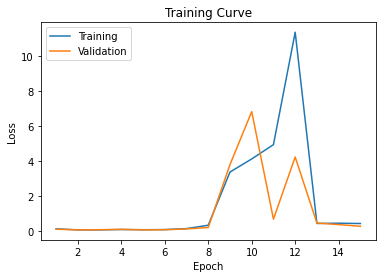

In [ ]:
# Training
model1 = Autoencoder()
max_epochs = 15
bs = 32
lr = 1e-3

use_cuda = True

if use_cuda and torch.cuda.is_available():
  model1.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

outputs1 = train(model1, num_epochs=max_epochs, batch_size=bs, learning_rate=lr)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

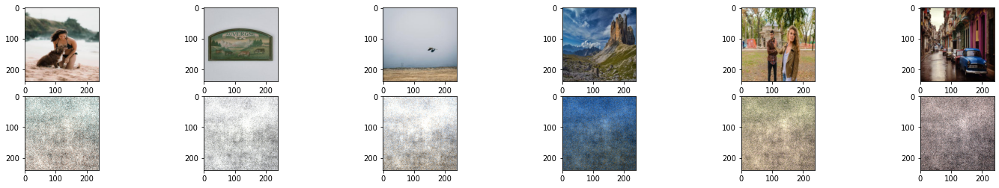

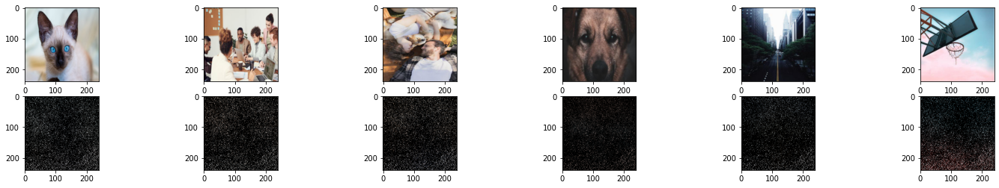

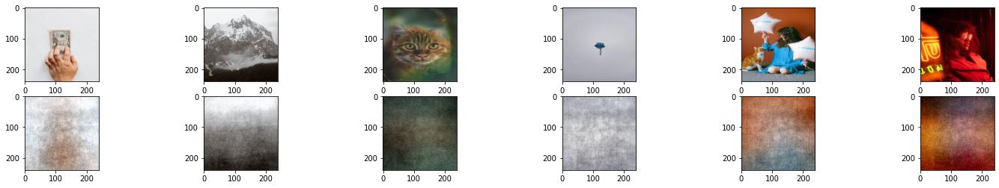

In [ ]:
# Compare the image without watermark and the reconstructed image (during the training process)
for k in range(0, max_epochs, 4):
    plt.figure(figsize=(25, 4))
    imgs = outputs1[k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = outputs1[k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    for i, item in enumerate(imgs):
        if i >= 6: break
        plt.subplot(2, 6, i+1)
        plt.imshow(item)
        
    for i, item in enumerate(recon):
        if i >= 6: break
        plt.subplot(2, 6, 6+i+1)
        plt.imshow(item)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


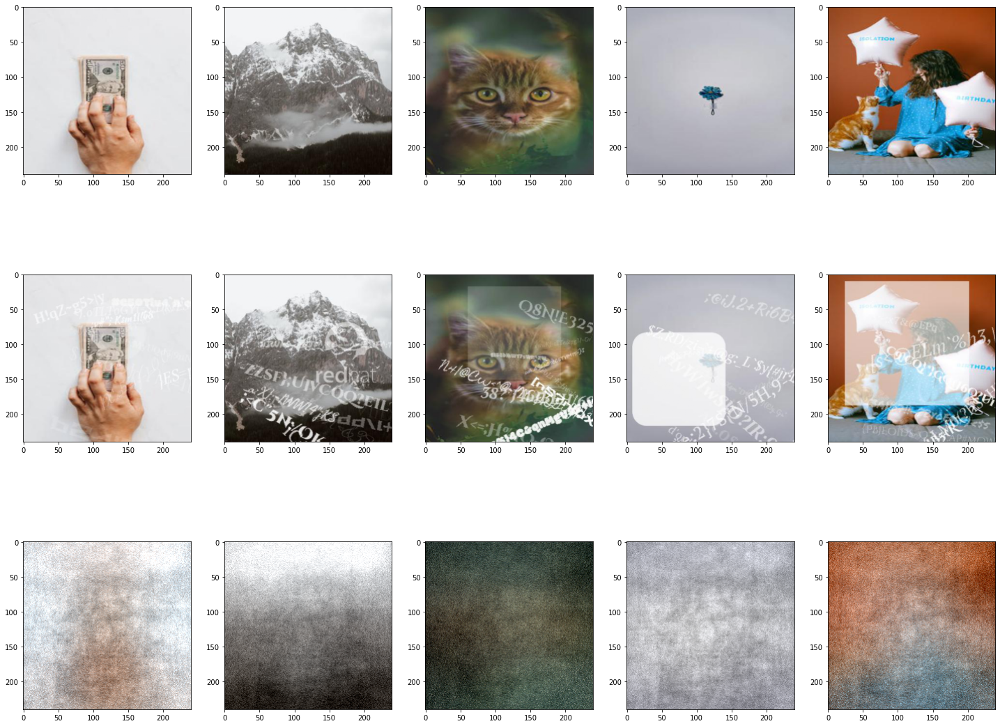

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)
l=[max_epochs-1]
numshow = 5
for k in l:
    plt.figure(figsize=(25, 20))
    imgs = outputs1[k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = outputs1[k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    imgswm = outputs1[k][3].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()

    for i, item in enumerate(imgs):
        if i >= numshow: break
        plt.subplot(3, numshow, 0*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(imgswm):
        if i >= numshow: break
        plt.subplot(3, numshow, 1*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(recon):
        if i >= numshow: break
        plt.subplot(3, numshow, 2*numshow+i+1)
        plt.imshow(item)

**Baseline Model Hyperparameter Tuning**

In [ ]:
# Tested different encoding dimensions, such as 100, 500, and 1000.
# However, none of these could reconstruct the original image content, not even mentioning removing watermarks.
# Since it is the baseline mode, we would like to keep the architecture simple.

CUDA is available!  Training on GPU ...
Epoch:1, Training Loss:0.0682, Validation Loss:0.0934
Epoch:2, Training Loss:0.0470, Validation Loss:0.0400
Epoch:3, Training Loss:0.0557, Validation Loss:0.1191
Epoch:4, Training Loss:0.0519, Validation Loss:0.0614
Epoch:5, Training Loss:0.0550, Validation Loss:0.0443
Epoch:6, Training Loss:0.0559, Validation Loss:0.0568
Epoch:7, Training Loss:0.1039, Validation Loss:0.0836
Epoch:8, Training Loss:0.1975, Validation Loss:0.1422
Epoch:9, Training Loss:2.6578, Validation Loss:2.3685
Epoch:10, Training Loss:1.0728, Validation Loss:0.8843
Epoch:11, Training Loss:0.7400, Validation Loss:0.3172
Epoch:12, Training Loss:0.3284, Validation Loss:0.2645
Epoch:13, Training Loss:0.1929, Validation Loss:0.1659
Epoch:14, Training Loss:0.4365, Validation Loss:0.1790
Epoch:15, Training Loss:0.2051, Validation Loss:0.1267
Epoch:16, Training Loss:0.2122, Validation Loss:0.2900
Epoch:17, Training Loss:0.2539, Validation Loss:0.6622
Epoch:18, Training Loss:1.3029, Va

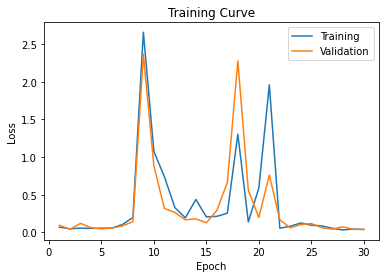

In [ ]:
# Training
model1 = Autoencoder()
max_epochs = 30
bs = 32
lr = 1e-3

use_cuda = True

if use_cuda and torch.cuda.is_available():
  model1.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

outputs1 = train(model1, num_epochs=max_epochs, batch_size=bs, learning_rate=lr)

**Baseline Model Final Testing**

In [ ]:
def final_testing(model):
  criterion = nn.MSELoss()
  outputs_test = []
  loss_list = []
  for i, (wm, nowm) in enumerate(test_loader):
    imgwm_test = wm[0].view(-1, pixelh * pixelw)
    recon_test = model(wm[0].cuda()).view(-1, pixelh * pixelw)
    truth_test = nowm[0].view(-1, pixelh * pixelw)
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      truth_test = truth_test.cuda()
      imgwm_test = imgwm_test.cuda()
      # sends truth_valid to the gpu
    #############################################
    loss_test_batch = criterion(recon_test, truth_test)
  loss_list.append((loss_test_batch.item()),) 
  outputs_test.append((truth_test, recon_test, imgwm_test),)
  loss_test = sum(loss_list)/len(loss_list)
  return loss_test, outputs_test

In [ ]:
# Change the model to be tested here !!!
result = final_testing(model1)

# Report the Final Testing Loss
print('Final Testing Loss: {:.4f}'.format(result[0]))

Final Testing Loss: 0.2246


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


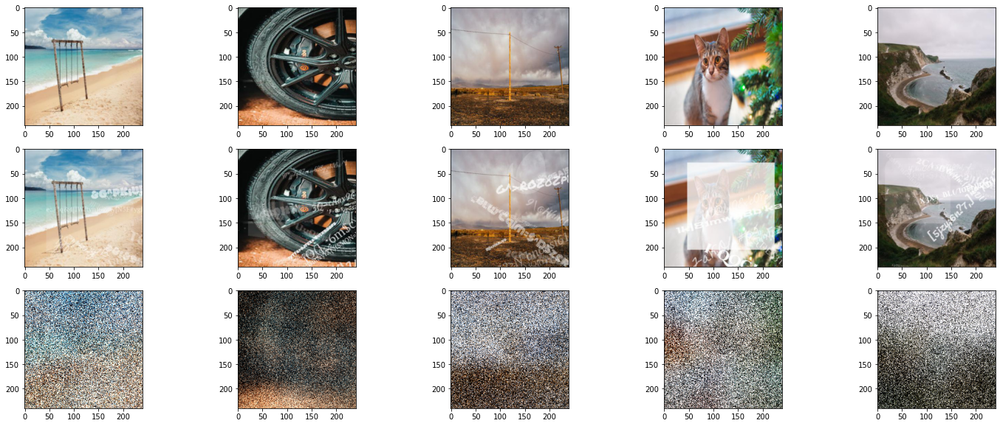

In [ ]:
# Visualize the Testing Result
numshow = 5
for k in range(0,int(len(result[1])),int(len(result[1]))):
    plt.figure(figsize=(25, 10))
    imgs = result[1][k][0].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = result[1][k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    imgswm = result[1][k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()

    for i, item in enumerate(imgs):
        if i >= numshow: break
        plt.subplot(3, numshow, 0*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(imgswm):
        if i >= numshow: break
        plt.subplot(3, numshow, 1*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(recon):
        if i >= numshow: break
        plt.subplot(3, numshow, 2*numshow+i+1)
        plt.imshow(item)

# **Primary Model**

**Primary Model Archiecture (Convolutional Autoencoder)**

In [ ]:
# 3 conv + 1 max popl + 3 conv
class Convolutional_Autoencoder_313(nn.Module):
    def __init__(self):
        super(Convolutional_Autoencoder_313, self).__init__()
        self.encoder = nn.Sequential( # like the Composition layer you built
            nn.Conv2d(in_channels=3, out_channels=20, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.Conv2d(in_channels=20, out_channels=30, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.Conv2d(in_channels=30, out_channels=40, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(in_channels=40, out_channels=50, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.Conv2d(in_channels=50, out_channels=60, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.Conv2d(in_channels=60, out_channels=70, kernel_size=3, stride=1, padding=0),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(70, 60, 3, stride=1,padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(60, 50, 3, stride=1,padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(50, 40, 3, stride=1, padding=0),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.ConvTranspose2d(40, 30, 3, stride=1,padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(30, 20, 3, stride=1,padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(20, 3, 3, stride=1,padding=0),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)    
        x = self.decoder(x)
        return x

**Primary Model Training**

In [ ]:
def train_conv(model, num_epochs=5, batch_size=32, learning_rate=1e-3):
    torch.manual_seed(42)
    criterion = nn.MSELoss() # mean square error loss
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)

    outputs = []
    iters = []
    losses = []
    losses_valid = []

    for epoch in range(num_epochs):

        for i, (wm, nowm) in enumerate(train_loader):
            imgwm = wm[0].view(-1, pixelh * pixelw)
            recon = model(wm[0].cuda())
            truth = nowm[0].view(-1, pixelh * pixelw)
            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              truth = truth.cuda()
              imgwm = imgwm.cuda()
            # sends truth_valid to the gpu
            #############################################
            loss = criterion(recon.view(-1, pixelh * pixelw), truth)             
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

        # validation_loader
        for i, (wm, nowm) in enumerate(valid_loader):
            recon_valid = model(wm[0].cuda())
            truth_valid = nowm[0].view(-1, pixelh * pixelw)
            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              truth_valid = truth_valid.cuda()
            # sends truth_valid to the gpu
            #############################################
            loss_valid = criterion(recon_valid.view(-1, pixelh * pixelw), truth_valid)

        # Track Training Accuracy
        print('Epoch:{}, Training Loss:{:.4f}, Validation Loss:{:.4f}'.format(epoch+1, float(loss), float(loss_valid)))
        losses.append(float(loss))
        losses_valid.append(float(loss_valid))
        iters.append(epoch+1)
        outputs.append((epoch, truth, recon, imgwm),)  
        
    plt.title("Training Curve")
    plt.plot(iters, losses, label="Train")
    plt.plot(iters, losses_valid, label="Validation")
    plt.xlabel("Epoch")
    plt.ylabel("Training Loss")
    plt.legend(loc='best')
    plt.show()
    return outputs

# **Training model 00**

CUDA is available!  Training on GPU ...
Epoch:1, Training Loss:0.0240, Validation Loss:0.0275
Epoch:2, Training Loss:0.0246, Validation Loss:0.0171
Epoch:3, Training Loss:0.0162, Validation Loss:0.0178
Epoch:4, Training Loss:0.0207, Validation Loss:0.0168
Epoch:5, Training Loss:0.0166, Validation Loss:0.0142
Epoch:6, Training Loss:0.0168, Validation Loss:0.0191
Epoch:7, Training Loss:0.0127, Validation Loss:0.0145
Epoch:8, Training Loss:0.0103, Validation Loss:0.0127
Epoch:9, Training Loss:0.0265, Validation Loss:0.0115
Epoch:10, Training Loss:0.0146, Validation Loss:0.0103
Epoch:11, Training Loss:0.0127, Validation Loss:0.0092
Epoch:12, Training Loss:0.0145, Validation Loss:0.0106
Epoch:13, Training Loss:0.0119, Validation Loss:0.0120
Epoch:14, Training Loss:0.0140, Validation Loss:0.0155
Epoch:15, Training Loss:0.0156, Validation Loss:0.0128
Epoch:16, Training Loss:0.0145, Validation Loss:0.0120
Epoch:17, Training Loss:0.0092, Validation Loss:0.0117
Epoch:18, Training Loss:0.0164, Va

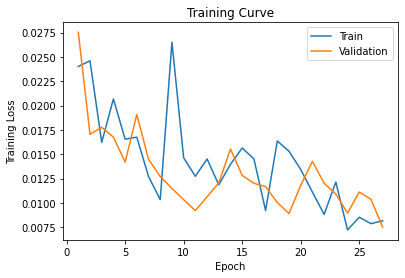

In [ ]:
# Training
pmodel00 = Convolutional_Autoencoder_313()
max_epochs = 27
bs = 32
lr = 1e-3

use_cuda = True

if use_cuda and torch.cuda.is_available():
  pmodel00.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

poutputs00 = train_conv(pmodel00, num_epochs=max_epochs, batch_size=bs, learning_rate=lr)

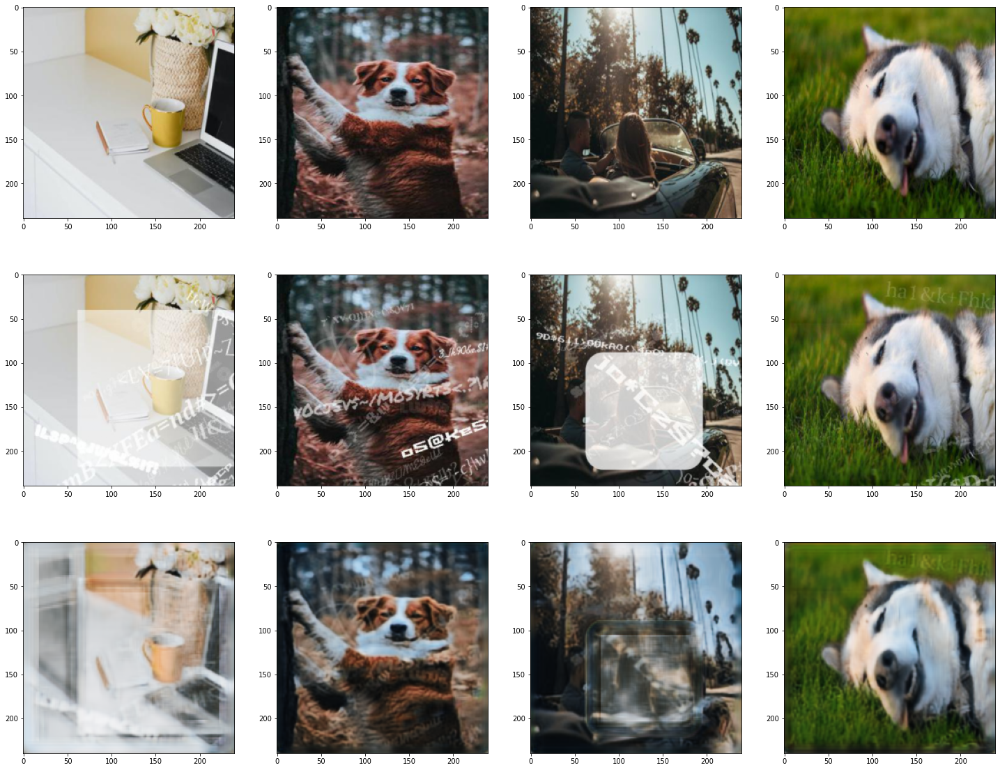

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)
k=max_epochs-1
numshow = 4

plt.figure(figsize=(25, 20))
imgs = poutputs00[k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
recon = poutputs00[k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
imgswm = poutputs00[k][3].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()

for i, item in enumerate(imgs):
  if i < numshow: 
    plt.subplot(3, numshow, 0*numshow+i+1)
    plt.imshow(item)

for i, item in enumerate(imgswm):
    if i < numshow:
      plt.subplot(3, numshow, 1*numshow+i+1)
      plt.imshow(item)

for i, item in enumerate(recon):
    if i < numshow:
      plt.subplot(3, numshow, 2*numshow+i+1)
      plt.imshow(item)

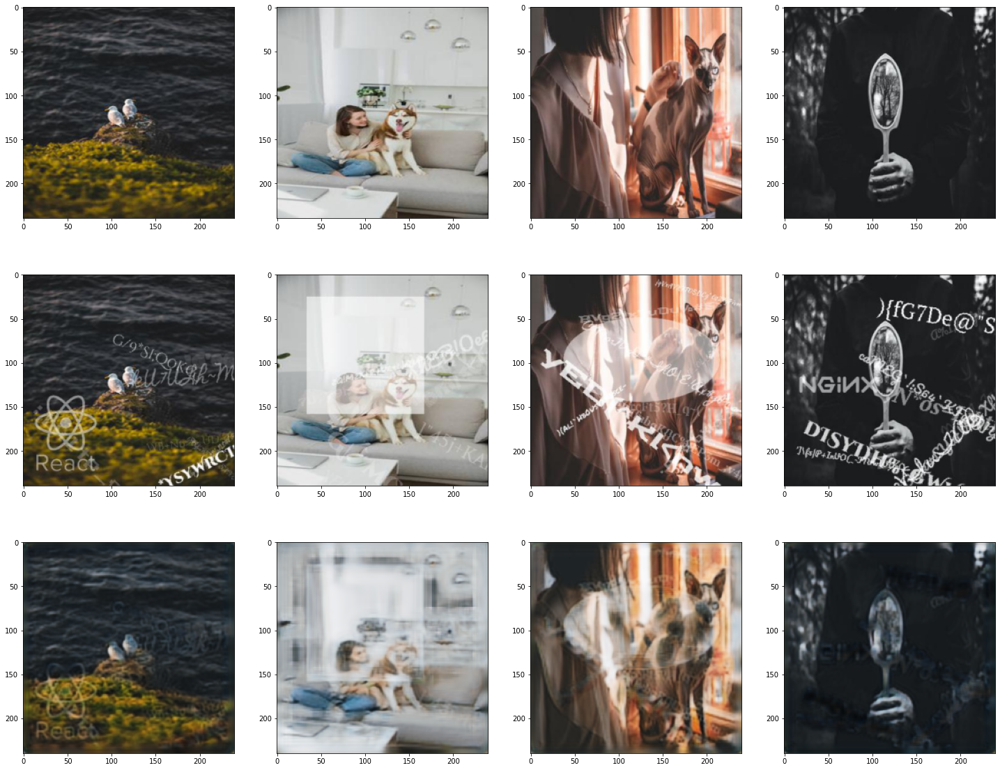

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)

plt.figure(figsize=(25, 20))

for i, item in enumerate(imgs):
  if numshow <= i < 2*numshow:
    plt.subplot(3, numshow, (-1)*numshow+i+1)
    plt.imshow(item)

for i, item in enumerate(imgswm):
    if numshow <= i < 2*numshow:
      plt.subplot(3, numshow, (0)*numshow+i+1)
      plt.imshow(item)

for i, item in enumerate(recon):
    if numshow <= i < 2*numshow:
      plt.subplot(3, numshow, (1)*numshow+i+1)
      plt.imshow(item)

# **Hyperparameter Tuning**

CUDA is available!  Training on GPU ...
Epoch:1, Training Loss:0.0239, Validation Loss:0.0318
Epoch:2, Training Loss:0.0265, Validation Loss:0.0183
Epoch:3, Training Loss:0.0165, Validation Loss:0.0183
Epoch:4, Training Loss:0.0236, Validation Loss:0.0179
Epoch:5, Training Loss:0.0166, Validation Loss:0.0139
Epoch:6, Training Loss:0.0200, Validation Loss:0.0202
Epoch:7, Training Loss:0.0113, Validation Loss:0.0135
Epoch:8, Training Loss:0.0108, Validation Loss:0.0144
Epoch:9, Training Loss:0.0267, Validation Loss:0.0125
Epoch:10, Training Loss:0.0101, Validation Loss:0.0103
Epoch:11, Training Loss:0.0105, Validation Loss:0.0102
Epoch:12, Training Loss:0.0121, Validation Loss:0.0106
Epoch:13, Training Loss:0.0101, Validation Loss:0.0104
Epoch:14, Training Loss:0.0116, Validation Loss:0.0150
Epoch:15, Training Loss:0.0197, Validation Loss:0.0102
Epoch:16, Training Loss:0.0137, Validation Loss:0.0107
Epoch:17, Training Loss:0.0101, Validation Loss:0.0097
Epoch:18, Training Loss:0.0152, Va

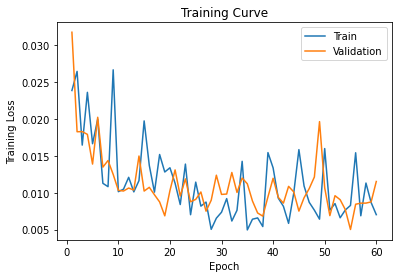

In [ ]:
# Training
pmodel0 = Convolutional_Autoencoder_313()
max_epochs = 60
bs = 32
lr = 1e-3

use_cuda = True

if use_cuda and torch.cuda.is_available():
  pmodel0.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

poutputs0 = train_conv(pmodel0, num_epochs=max_epochs, batch_size=bs, learning_rate=lr)

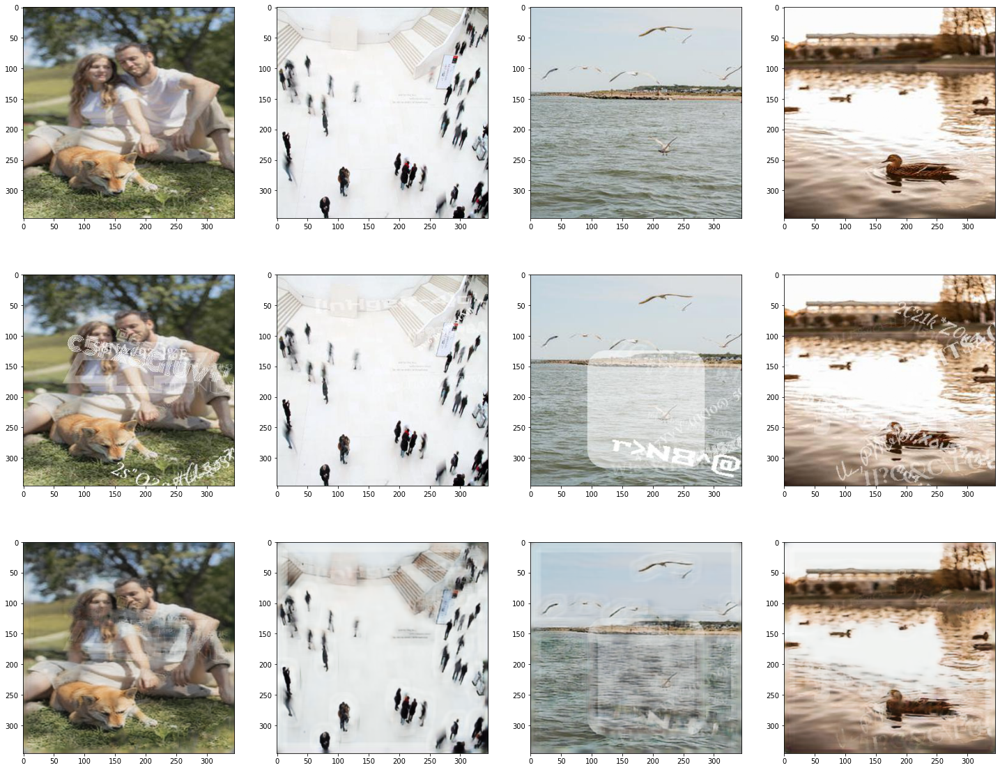

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)
k=max_epochs-1
numshow = 4

plt.figure(figsize=(25, 20))
imgs = poutputs0[k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
recon = poutputs0[k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
imgswm = poutputs0[k][3].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()

for i, item in enumerate(imgs):
  if i < numshow: 
    plt.subplot(3, numshow, 0*numshow+i+1)
    plt.imshow(item)

for i, item in enumerate(imgswm):
    if i < numshow:
      plt.subplot(3, numshow, 1*numshow+i+1)
      plt.imshow(item)

for i, item in enumerate(recon):
    if i < numshow:
      plt.subplot(3, numshow, 2*numshow+i+1)
      plt.imshow(item)

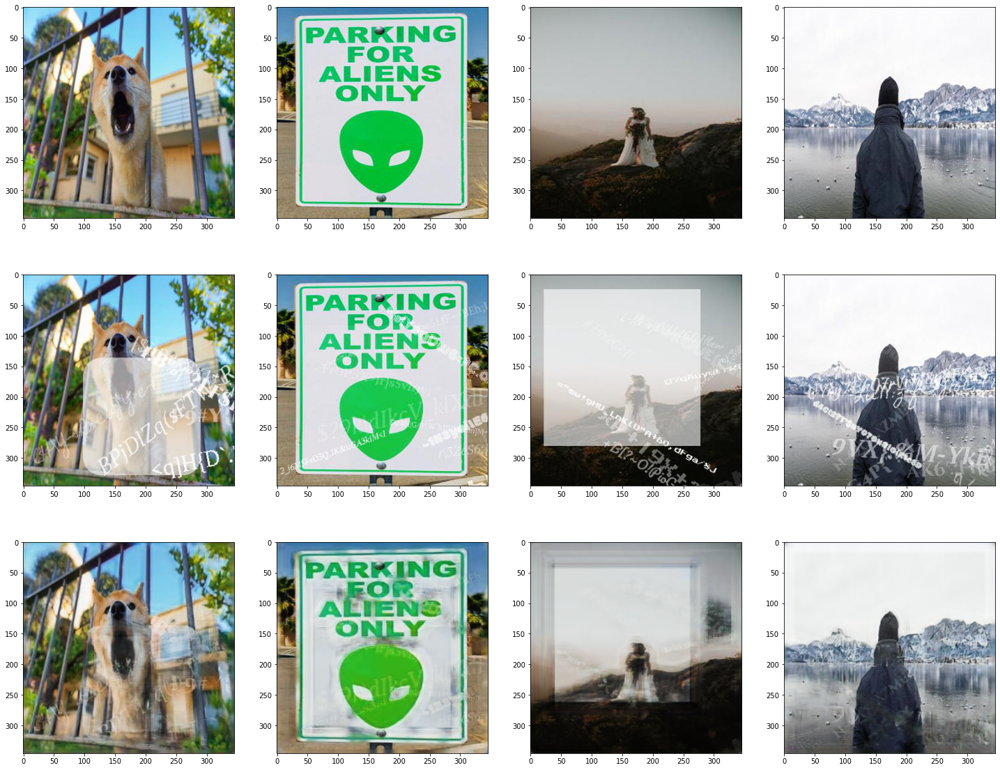

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)

plt.figure(figsize=(25, 20))

for i, item in enumerate(imgs):
  if numshow <= i < 2*numshow:
    plt.subplot(3, numshow, (-1)*numshow+i+1)
    plt.imshow(item)

for i, item in enumerate(imgswm):
    if numshow <= i < 2*numshow:
      plt.subplot(3, numshow, (0)*numshow+i+1)
      plt.imshow(item)

for i, item in enumerate(recon):
    if numshow <= i < 2*numshow:
      plt.subplot(3, numshow, (1)*numshow+i+1)
      plt.imshow(item)

CUDA is available!  Training on GPU ...
Epoch:1, Training Loss:0.0267, Validation Loss:0.0315
Epoch:2, Training Loss:0.0285, Validation Loss:0.0179
Epoch:3, Training Loss:0.0206, Validation Loss:0.0203
Epoch:4, Training Loss:0.0333, Validation Loss:0.0229
Epoch:5, Training Loss:0.0176, Validation Loss:0.0140
Epoch:6, Training Loss:0.0203, Validation Loss:0.0208
Epoch:7, Training Loss:0.0108, Validation Loss:0.0155
Epoch:8, Training Loss:0.0102, Validation Loss:0.0155
Epoch:9, Training Loss:0.0289, Validation Loss:0.0126
Epoch:10, Training Loss:0.0105, Validation Loss:0.0102
Epoch:11, Training Loss:0.0100, Validation Loss:0.0104
Epoch:12, Training Loss:0.0127, Validation Loss:0.0112
Epoch:13, Training Loss:0.0107, Validation Loss:0.0111
Epoch:14, Training Loss:0.0127, Validation Loss:0.0161
Epoch:15, Training Loss:0.0196, Validation Loss:0.0107
Epoch:16, Training Loss:0.0156, Validation Loss:0.0115
Epoch:17, Training Loss:0.0136, Validation Loss:0.0102
Epoch:18, Training Loss:0.0186, Va

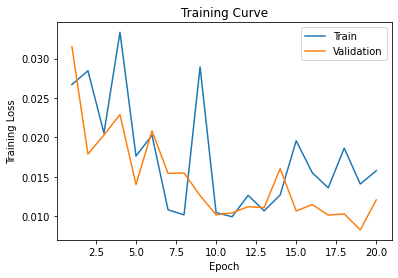

In [ ]:
# Training
pmodel1 = Convolutional_Autoencoder_313()
max_epochs = 20
bs = 32
lr = 1e-3

use_cuda = True

if use_cuda and torch.cuda.is_available():
  pmodel1.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

poutputs1 = train_conv(pmodel1, num_epochs=max_epochs, batch_size=bs, learning_rate=lr)

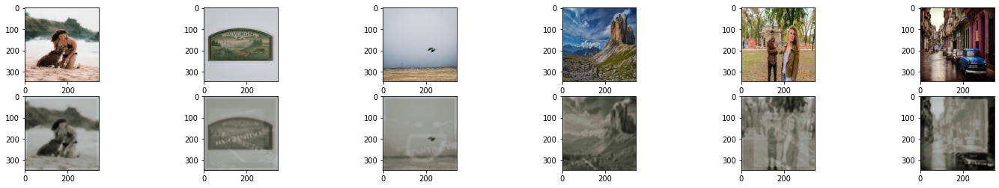

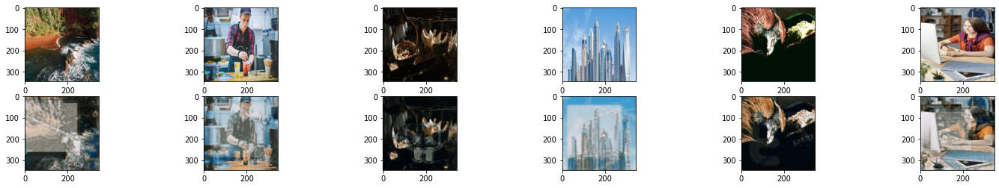

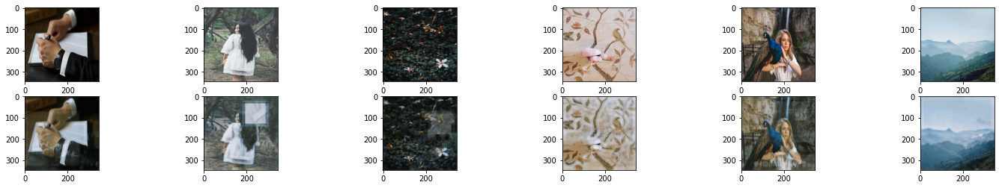

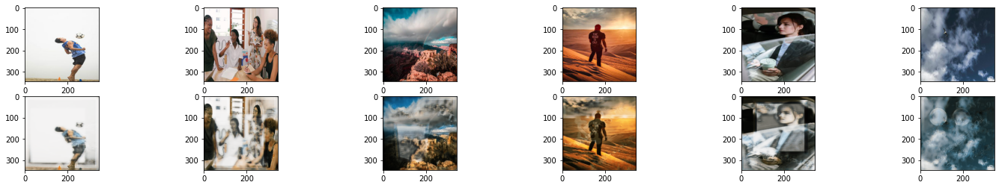

In [ ]:
# Compare the image without watermark and the reconstructed image (during the training process)
for k in range(0, max_epochs, 5):
    plt.figure(figsize=(25, 4))
    imgs = poutputs1[k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = poutputs1[k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    for i, item in enumerate(imgs):
        if i >= 6: break
        plt.subplot(2, 6, i+1)
        plt.imshow(item)
        
    for i, item in enumerate(recon):
        if i >= 6: break
        plt.subplot(2, 6, 6+i+1)
        plt.imshow(item)

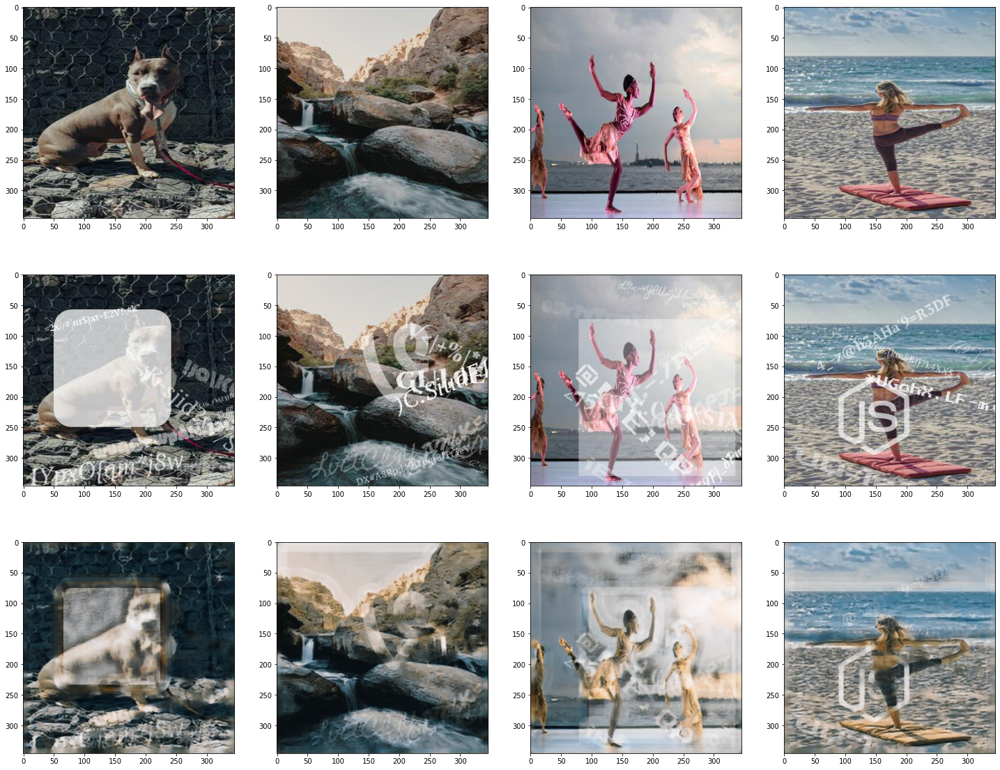

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)
k=max_epochs-1
numshow = 4

plt.figure(figsize=(25, 20))
imgs = poutputs1[k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
recon = poutputs1[k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
imgswm = poutputs1[k][3].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()

for i, item in enumerate(imgs):
  if i < numshow: 
    plt.subplot(3, numshow, 0*numshow+i+1)
    plt.imshow(item)

for i, item in enumerate(imgswm):
    if i < numshow:
      plt.subplot(3, numshow, 1*numshow+i+1)
      plt.imshow(item)

for i, item in enumerate(recon):
    if i < numshow:
      plt.subplot(3, numshow, 2*numshow+i+1)
      plt.imshow(item)

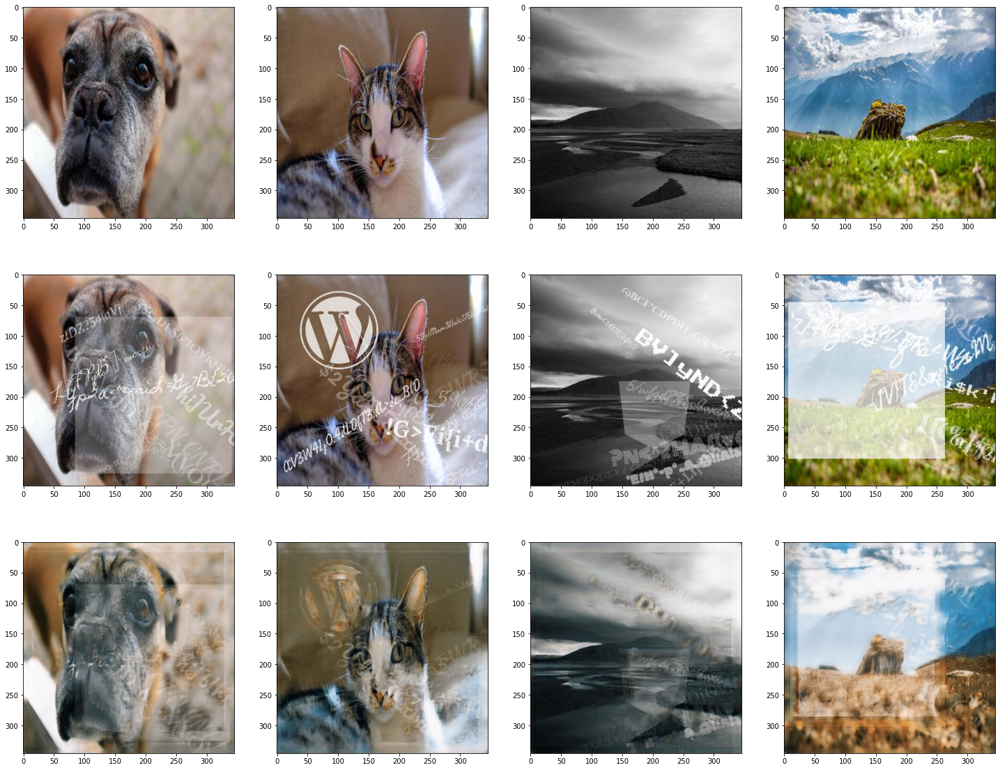

In [ ]:
# Compare the image with/without watermark and the reconstructed image (at the end of training)

plt.figure(figsize=(25, 20))

for i, item in enumerate(imgs):
  if numshow <= i < 2*numshow:
    plt.subplot(3, numshow, (-1)*numshow+i+1)
    plt.imshow(item)

for i, item in enumerate(imgswm):
    if numshow <= i < 2*numshow:
      plt.subplot(3, numshow, 0*numshow+i+1)
      plt.imshow(item)

for i, item in enumerate(recon):
    if numshow <= i < 2*numshow:
      plt.subplot(3, numshow, 1*numshow+i+1)
      plt.imshow(item)

# **Testing model 00**

In [ ]:
def final_testing(model):
  criterion = nn.MSELoss()
  outputs_test = []
  loss_list = []
  for i, (wm, nowm) in enumerate(test_loader):
    imgwm_test = wm[0].view(-1, pixelh * pixelw)
    recon_test = model(wm[0].cuda()).view(-1, pixelh * pixelw)
    truth_test = nowm[0].view(-1, pixelh * pixelw)
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      truth_test = truth_test.cuda()
      imgwm_test = imgwm_test.cuda()
      # sends truth_valid to the gpu
    #############################################
    loss_test_batch = criterion(recon_test, truth_test)
  loss_list.append((loss_test_batch.item()),) 
  outputs_test.append((truth_test, recon_test, imgwm_test),)
  loss_test = sum(loss_list)/len(loss_list)
  return loss_test, outputs_test

In [ ]:
# Change the model to be tested here !!!
result = final_testing(pmodel00)

# Report the Final Testing Loss
print('Final Testing Loss: {:.4f}'.format(result[0]))

Final Testing Loss: 0.0112


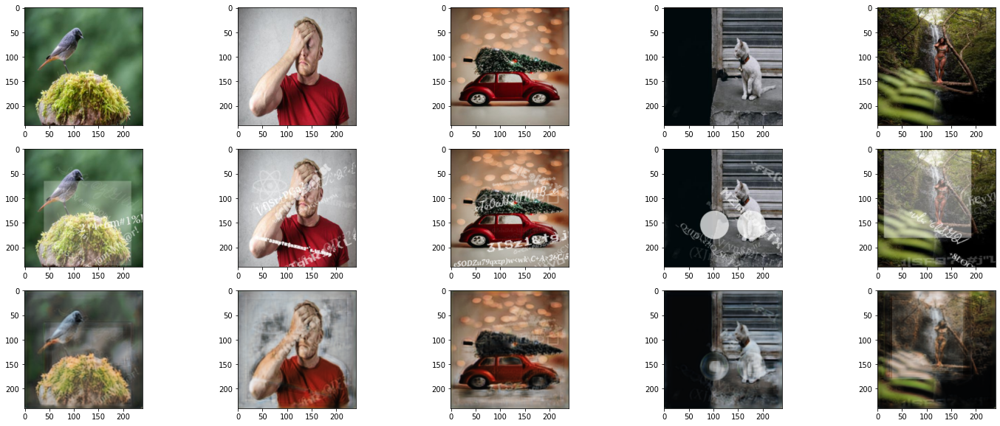

In [ ]:
# Visualize the Testing Result
numshow = 5
for k in range(0,int(len(result[1])),int(len(result[1]))):
    plt.figure(figsize=(25, 10))
    imgs = result[1][k][0].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = result[1][k][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    imgswm = result[1][k][2].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()

    for i, item in enumerate(imgs):
        if i >= numshow: break
        plt.subplot(3, numshow, 0*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(imgswm):
        if i >= numshow: break
        plt.subplot(3, numshow, 1*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(recon):
        if i >= numshow: break
        plt.subplot(3, numshow, 2*numshow+i+1)
        plt.imshow(item)

# **Demo1 model 00**

In [ ]:
# Load data from Google Drive
demo = torchvision.datasets.ImageFolder('/content/gdrive/My Drive/APS360 Project Group 33/Demo/', transform=transform)
demo_loader = torch.utils.data.DataLoader(demo, batch_size=batch_size, num_workers=num_workers, shuffle=True)

In [ ]:
def demo_testing(model):
  criterion = nn.MSELoss()
  outputs_demo = []
  for wm in demo_loader:
    imgwm_demo = wm[0].view(-1, pixelh * pixelw)
    recon_demo = model(wm[0].cuda()).view(-1, pixelh * pixelw)
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgwm_demo = imgwm_demo.cuda()
      # sends truth_valid to the gpu
    #############################################
  outputs_demo.append((imgwm_demo, recon_demo),)
  return outputs_demo

In [ ]:
demo_result = demo_testing(pmodel00)

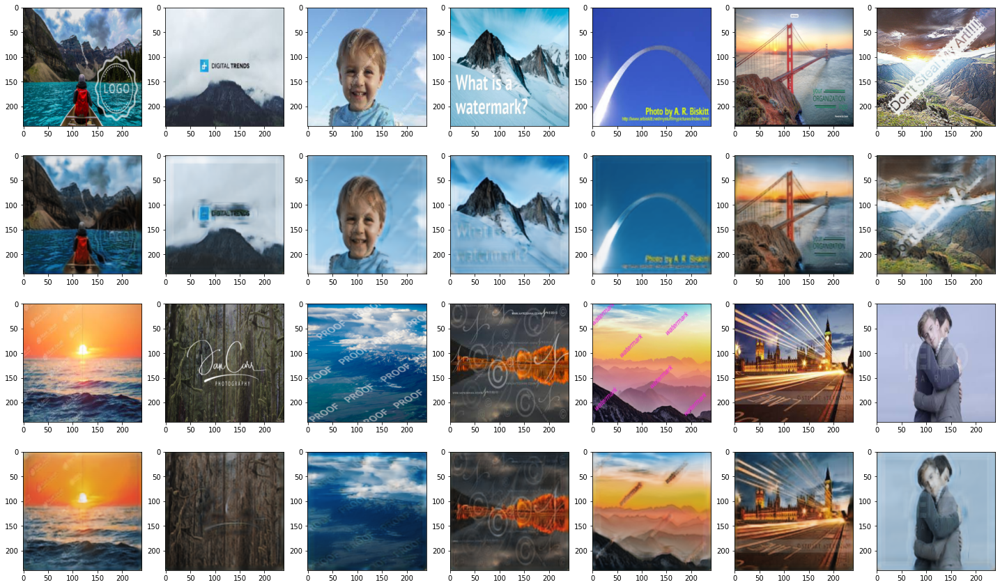

In [ ]:
# Visualize the Demo Result
numshow = 7
for k in range(0,int(len(demo_result)),int(len(demo_result))):
    plt.figure(figsize=(25, 15))
    imgswm = demo_result[0][0].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = demo_result[0][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    
    for i, item in enumerate(imgswm):
      if i < numshow:
        plt.subplot(4, numshow, 0*numshow+i+1)
        plt.imshow(item)
      if numshow <= i < 2*numshow:
        plt.subplot(4, numshow, 1*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(recon):
      if i < numshow:
        plt.subplot(4, numshow, 1*numshow+i+1)
        plt.imshow(item)
      if numshow <= i < 2*numshow:
        plt.subplot(4, numshow, 2*numshow+i+1)
        plt.imshow(item)

# **Demo2 model 00**

In [ ]:
# Load data from Google Drive
demo2 = torchvision.datasets.ImageFolder('/content/gdrive/My Drive/APS360 Project Group 33/Demo2/', transform=transform)
demo2_loader = torch.utils.data.DataLoader(demo2, batch_size=batch_size, num_workers=num_workers, shuffle=True)

In [ ]:
def demo2_testing(model):
  criterion = nn.MSELoss()
  outputs_demo = []
  for wm in demo2_loader:
    imgwm_demo = wm[0].view(-1, pixelh * pixelw)
    recon_demo = model(wm[0].cuda()).view(-1, pixelh * pixelw)
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgwm_demo = imgwm_demo.cuda()
      # sends truth_valid to the gpu
    #############################################
  outputs_demo.append((imgwm_demo, recon_demo),)
  return outputs_demo

In [ ]:
demo2_result = demo2_testing(pmodel00)

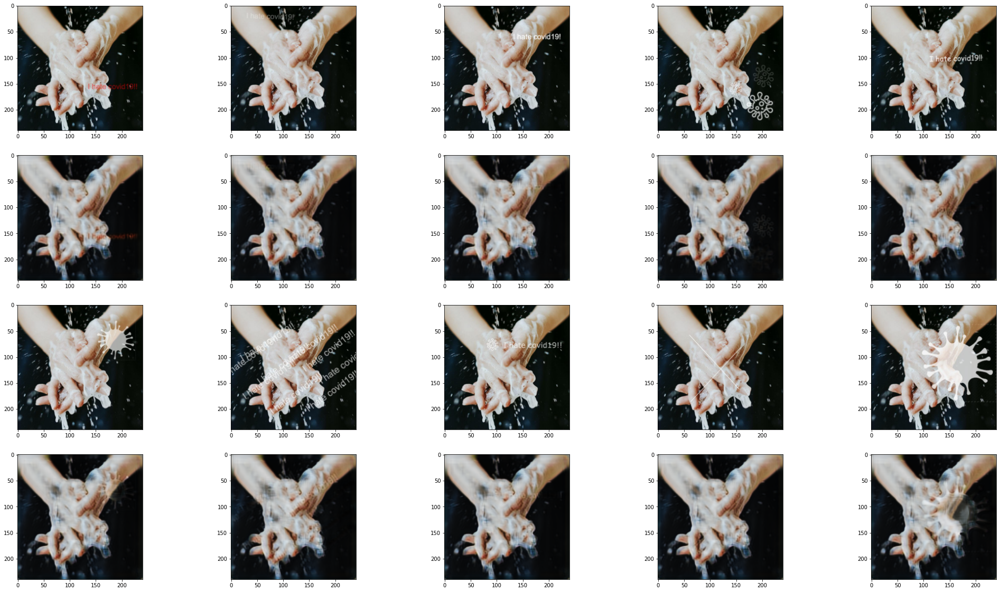

In [ ]:
# Visualize the Demo Result
numshow = 5
for k in range(0,int(len(demo2_result)),int(len(demo2_result))):
    plt.figure(figsize=(35, 20))
    imgswm = demo2_result[0][0].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = demo2_result[0][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    
    for i, item in enumerate(imgswm):
      if i < numshow:
        plt.subplot(4, numshow, 0*numshow+i+1)
        plt.imshow(item)
      if numshow <= i < 2*numshow:
        plt.subplot(4, numshow, 1*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(recon):
      if i < numshow:
        plt.subplot(4, numshow, 1*numshow+i+1)
        plt.imshow(item)
      if numshow <= i < 2*numshow:
        plt.subplot(4, numshow, 2*numshow+i+1)
        plt.imshow(item)

# **Demo3 model 00**

In [ ]:
# Load data from Google Drive
demo3 = torchvision.datasets.ImageFolder('/content/gdrive/My Drive/APS360 Project Group 33/demo3/', transform=transform)
demo3_loader = torch.utils.data.DataLoader(demo3, batch_size=batch_size, num_workers=num_workers, shuffle=True)

def demo3_testing(model):
  criterion = nn.MSELoss()
  outputs_demo = []
  for wm in demo3_loader:
    imgwm_demo = wm[0].view(-1, pixelh * pixelw)
    recon_demo = model(wm[0].cuda()).view(-1, pixelh * pixelw)
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgwm_demo = imgwm_demo.cuda()
      # sends truth_valid to the gpu
    #############################################
  outputs_demo.append((imgwm_demo, recon_demo),)
  return outputs_demo

demo3_result = demo3_testing(pmodel00)

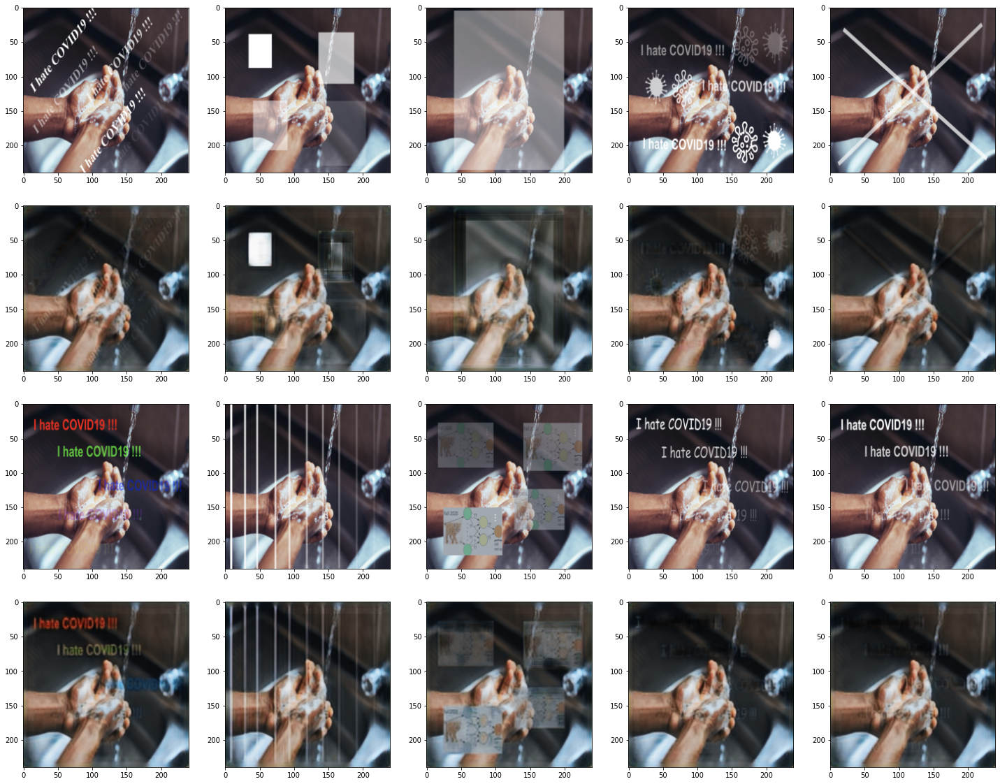

In [ ]:
# Visualize the Demo Result
numshow = 5
for k in range(0,int(len(demo3_result)),int(len(demo3_result))):
    plt.figure(figsize=(25, 20))
    imgswm = demo3_result[0][0].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    recon = demo3_result[0][1].reshape(-1,3,pixelh,pixelw).permute(0,2,3,1).detach().cpu().numpy()
    
    for i, item in enumerate(imgswm):
      if i < numshow:
        plt.subplot(4, numshow, 0*numshow+i+1)
        plt.imshow(item)
      if numshow <= i < 2*numshow:
        plt.subplot(4, numshow, 1*numshow+i+1)
        plt.imshow(item)

    for i, item in enumerate(recon):
      if i < numshow:
        plt.subplot(4, numshow, 1*numshow+i+1)
        plt.imshow(item)
      if numshow <= i < 2*numshow:
        plt.subplot(4, numshow, 2*numshow+i+1)
        plt.imshow(item)